In [43]:
import Pkg
Pkg.add("MAT")
Pkg.add("Images")
Pkg.add("Plots")

   Resolving package versions...
  No Changes to `C:\Users\user\.julia\environments\v1.11\Project.toml`
  No Changes to `C:\Users\user\.julia\environments\v1.11\Manifest.toml`
   Resolving package versions...
  No Changes to `C:\Users\user\.julia\environments\v1.11\Project.toml`
  No Changes to `C:\Users\user\.julia\environments\v1.11\Manifest.toml`
   Resolving package versions...
  No Changes to `C:\Users\user\.julia\environments\v1.11\Project.toml`
  No Changes to `C:\Users\user\.julia\environments\v1.11\Manifest.toml`


In [3]:
# using Pkg
# Pkg.add("Images")
# Pkg.add("MAT")

using MAT
using Plots
using Images


pyplot()

file = matopen("D:/COURS/PJULIA/Hyperspectral-image-unmixing-Julia/project_data.mat")
img = read(file, "im")
sources = read(file,"sources")
rgb = read(file,"rgb")
close(file)

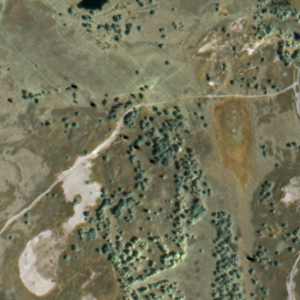

In [45]:
# visualize data in rgb (using bands 67,109,141 as th RGB channels)
p1 = colorview(RGB,permutedims(rgb,(3,1,2))) # convert 3d array to the image format used by julia

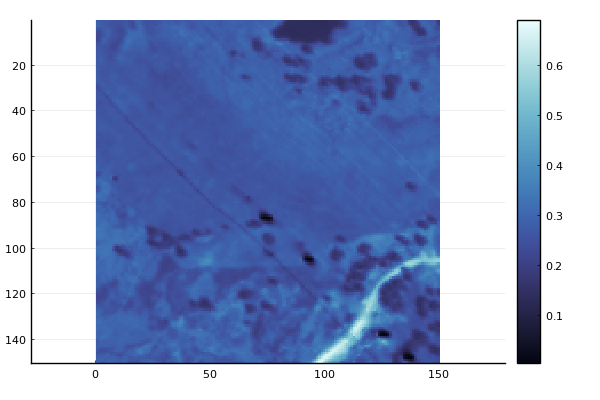

In [20]:
#visualize a spectral band on its own
p2 = heatmap(img[1:150,1:150,150],aspect_ratio=1, yflip = true,c=:ice)

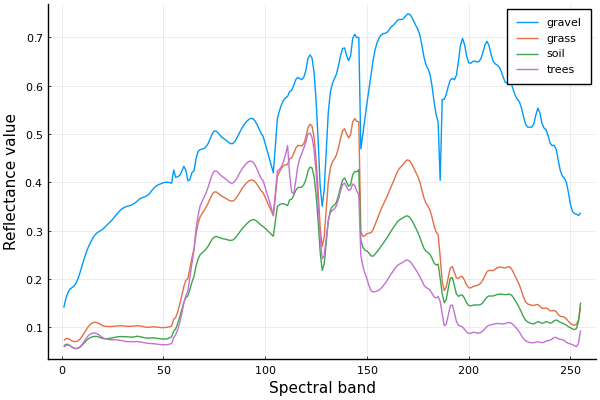

In [2]:
# visualize the endmembers to be used

plot(sources[:,1],label = "gravel")
plot!(sources[:,2],label = "grass")
plot!(sources[:,3],label = "soil")
plot!(sources[:,4],label = "trees")
xlabel!("Spectral band")
ylabel!("Reflectance value")

# Unmixing the image

The model we are using to decompose the image into the sum of the contributions of the endmembers is:

\begin{equation*}
\mathbf{X} = \mathbf{S}\mathbf{A} + \mathbf{E} 
\end{equation*}

 $\mathbf{X}\in \mathbb{R}^{L\times N}$ : data matrix
 
 $\mathbf{S}\in \mathbb{R}^{L\times P}$ : endmember matrix
 
 $\mathbf{A}\in \mathbb{R}^{P\times N}$ : abundance matrix
 
 $\mathbf{E}\in \mathbb{R}^{L\times N}$ : additive noise matrix
 
 where $L$ is the number of spectral bands, $P$ is the number of materials, and $N$ is the number of pixels
 
 The hyperspectral image is represented as a matrix with $N$ pixels, so the first thing to do is to reshape the image to a big matrix.

We can try and estimate the abundance matrix using a least squares formulation:

\begin{equation*}
\hat{A} = \underset{\mathbf{A}>\mathbf{0}, \mathbf{1}_{P}^T \mathbf{A} = \mathbf{1}_{N}^{T} }{\textrm{arg min}}\frac{1}{2}||\mathbf{X}-\mathbf{SA}||_{F}^{2} = \underset{\mathbf{A}>\mathbf{0}, \mathbf{1}_{P}^T \mathbf{A} = \mathbf{1}_{N}^{T} }{\textrm{arg min}}\frac{1}{2} \sum_{i=1}^{N} ||\mathbf{x}_{n}-\mathbf{S}\mathbf{a}_{n}||_{2}^{2}
\end{equation*}

where $\mathbf{1}_{.}$ is a vector of ones whose size is given in index 

Choose an algorithm to solve the optimization problem, and implement it both in a serial version and a version parallelized across the pixels.

In [ ]:
import Pkg
Pkg.add("PyCall")
Pkg.add("Noise")

# Estimation of A on whole image with PGD (ANC only)

In [4]:
using PyCall
using Noise
using LinearAlgebra

H_img, W_img, L = size(img)

#img_small = img[1:100,1:100,:]; # use a small crop of the image first
img_small = copy(img);
#img_small = img[H_img-99:H_img, 1:100, :]

#Serial Version
H, W, L = size(img_small)
X = reshape(permutedims(img_small, (3,1,2)), L, H*W)

#S
S = sources


255×4 Matrix{Float64}:
 0.140573  0.0729046  0.0615242  0.0586843
 0.158488  0.0760527  0.0643978  0.062294
 0.171616  0.076714   0.0646464  0.0633683
 0.178735  0.0747669  0.0622242  0.0617023
 0.182148  0.0720109  0.0589983  0.0589145
 0.185337  0.0702141  0.0566283  0.0566373
 0.191106  0.0701555  0.0558101  0.0557707
 0.200659  0.0719321  0.0566624  0.0566585
 0.213372  0.0755275  0.0590986  0.0594181
 0.227553  0.0809532  0.0629096  0.0641206
 0.241597  0.0878603  0.0675866  0.0704353
 0.254347  0.0951185  0.0721864  0.0770832
 0.265181  0.101277   0.0758123  0.082386
 ⋮                               
 0.447272  0.126563   0.112988   0.0762418
 0.42492   0.122801   0.110153   0.0747841
 0.412983  0.122072   0.10854    0.0742898
 0.409144  0.120942   0.107088   0.0723655
 0.4002    0.117284   0.104375   0.0690625
 0.379494  0.112302   0.101239   0.0665919
 0.355365  0.107839   0.0988444  0.0655163
 0.339807  0.104961   0.096655   0.0641077
 0.335376  0.104327   0.0949993  0.0614907

In [6]:
using PyCall
using Noise
using LinearAlgebra


#A
A = ones(4,H*W)


#Loop with ANC constraint only

t0 = time() #starting the timer

epsilon = 0.001
max_iter = 80

#step size
lambdas = eigvals(S'*S)
stepsize = 1 / (2 * maximum(eigvals(S' * S)))

current_k = 1 #iteration for each W*L pixels 
local_iteration = 0 #iterations per pixel

#pre computation 
StS = S' * S
StX = S' * X

while current_k < W*H + 1
            
    a = view(A, :, current_k)
    a_initial = similar(a)
    copyto!(a_initial, a)
    
    while norm(min.(a, StS*a - StX[:,current_k])) > epsilon && local_iteration < max_iter
        
        a .-= 2*stepsize * (StS*a - StX[:,current_k]) #gradient descent
        
        #projection 
        a .= max.(a, 0) #ANC constraint
                         
        
        local_iteration +=1
    end
    
    #println("norme de J: ",J(current_k),"\n")
    local_iteration = 0
    current_k += 1
    
end 
t1 = time()

println("Running time (s): ", t1 - t0,"\n")
println("Cost || X - SA ||² = ", norm(X - S*A)^2)



Running time (s): 9.384999990463257

Cost || X - SA ||² = 9548.588028290063


# Plots on image crop (ANC only)

We decided to select a specific area (left bottom corner) of the orignal image , that had different endmembers cleary represented (avoiding the plot on the whole image which takes a long time).

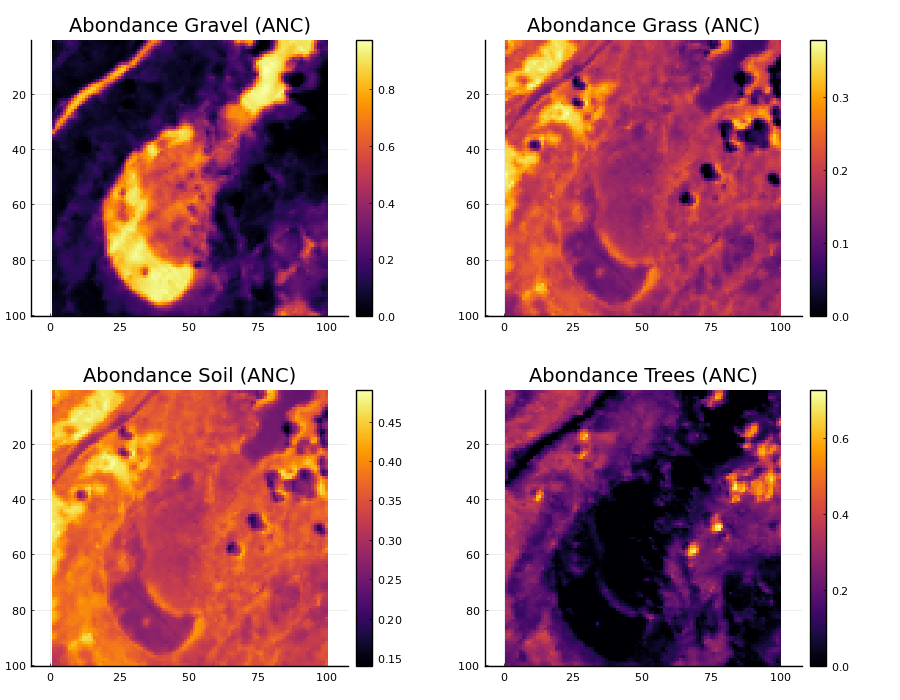

In [62]:
#Plots of the resulting Abundances with ANC only on image crop
using Plots
pyplot()

# crop
rows = H_img-99:H_img     # 100 last rows
cols = 1:100              # 100 first columns

# indexes
inds = Int[]
for j in cols
    for i in rows
        push!(inds, (j-1)*H_img + i)
    end
end

# Extraction of abundances for this crop
A_crop = A[:, inds]   # taille : 4 × (100*100)

# Reshape for display
A1 = reshape(A_crop[1, :], 100, 100)
A2 = reshape(A_crop[2, :], 100, 100)
A3 = reshape(A_crop[3, :], 100, 100)
A4 = reshape(A_crop[4, :], 100, 100)

# Plots
p1 = heatmap(A1, title="Abondance Gravel (ANC)", aspect_ratio=1, yflip=true)
p2 = heatmap(A2, title="Abondance Grass (ANC)",  aspect_ratio=1, yflip=true)
p3 = heatmap(A3, title="Abondance Soil (ANC)",   aspect_ratio=1, yflip=true)
p4 = heatmap(A4, title="Abondance Trees (ANC)",  aspect_ratio=1, yflip=true)

plot(p1, p2, p3, p4, layout=(2,2), size=(900,700))



We can see as a result that above some of the endmembers are more represented in the image's sample than others. For instance we can say with good trust that the Gravel endmember is weakly represented outside the peanut (dark zone of image 1), and that the Trees are weakly represented inside the peanut area (image 4) but strongly represented on the right of the image, which is objectively accurate . Furthermore , we can see that the remaining endmembers (Grass, Soil) present comparable abundance levels over most of the area except where trees are. 

Thus, we can say that this estimation (with ANC only) can be a good first approach regardind the execution time which is reasonable. The addition of the ASC constraint (that we are about to make) can help us figure out with more precision how are the endmembers distributed over this sample. Indeed, since ANC alone does not enforce any normalization, the relative importance of the endmembers remains ambiguous. Enforcing the ASC constraint ensures that abundances sum to one, leading to a much more physically interpretable distribution.

# Estimation of A on whole image with PGD (ANC + ASC )

In [7]:
#Function that allow the projection of a vector a on the simplew (ASC + ANC)
function proj_simplex(a)
    # Projection of a on {x>= 0, sum(x)=1}
    v = collect(a)                 
    u = sort(v, rev=true)          
    cssv = cumsum(u)              

    rho = 0
    tau = 0.0
    for k in 1:length(u)
        t = (cssv[k] - 1.0) / k
        if u[k] > t
            rho = k
            tau = t
        end
    end

    @. a = max(a - tau, 0.0)
    return a
end

proj_simplex (generic function with 1 method)

In [7]:
#Resolution with both ANC and ASC constraints => Projection on simplex


#reloading A
A = ones(4,H*W)


#Starting PGD ANC + ASC
t0 = time() #starting the timer

epsilon = 0.001
max_iter = 80

#step size
lambdas = eigvals(S'*S)
stepsize = 1 / (2 * maximum(eigvals(S' * S)))

current_k = 1 #iteration for each W*L pixels 


#pre computation 
StS = S' * S
StX = S' * X


while current_k < W*H + 1
            
    a = view(A, :, current_k)
    a_initial = similar(a)
    copyto!(a_initial, a)
    local_iteration = 0 #iterations per pixel
    
    while norm(min.(a, StS*a - StX[:,current_k])) > epsilon && local_iteration < max_iter
        
        a .-= 2*stepsize * (StS*a - StX[:,current_k]) #gradient descent
        
        #projection
        proj_simplex(a)  # ANC + ASC
                         
        
        local_iteration +=1
    end
    
    #println("norme de J: ",J(current_k),"\n")
    local_iteration = 0
    current_k += 1
    
end 

#print(A[:,1])

t1 = time()

println("Running time (s): ", t1 - t0,"\n")
println("Cost || X - SA ||² = ", norm(X - S*A)^2)




Running time (s): 10.315000057220459

Cost || X - SA ||² = 48738.64079150193


# Plots on image crop (ANC + ASC)

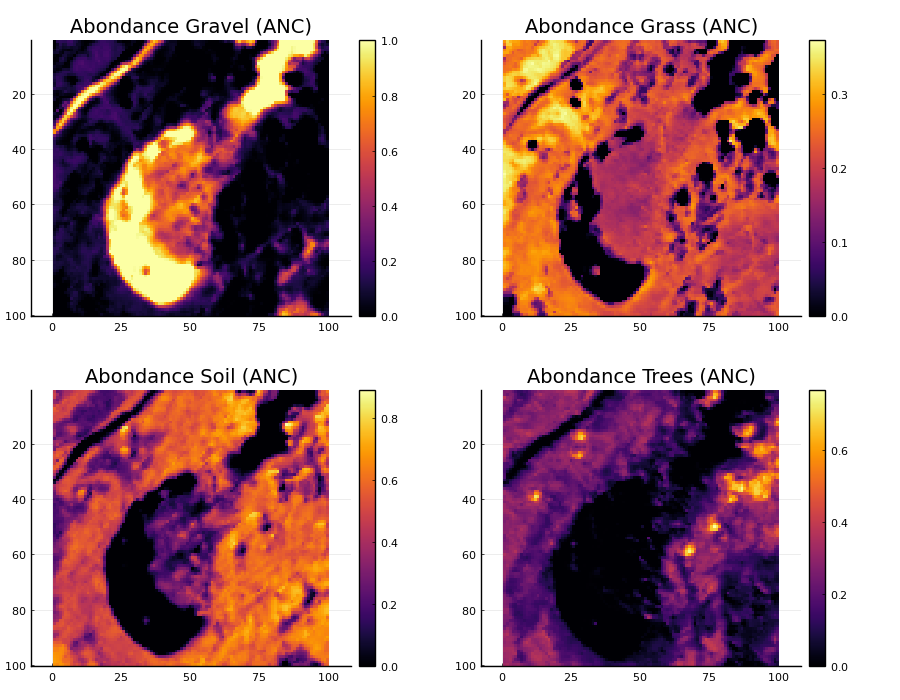

In [12]:
#Plots of the resulting Abundances with ANC + ASC
using Plots
pyplot()

# crop
rows = H_img-99:H_img     # 100 last rows
cols = 1:100              # 100 first columns

# indexes
inds = Int[]
for j in cols
    for i in rows
        push!(inds, (j-1)*H_img + i)
    end
end

# Extraction of abundances for this crop
A_crop = A[:, inds]   # taille : 4 × (100*100)

# Reshape for display
A1 = reshape(A_crop[1, :], 100, 100)
A2 = reshape(A_crop[2, :], 100, 100)
A3 = reshape(A_crop[3, :], 100, 100)
A4 = reshape(A_crop[4, :], 100, 100)

# Plots
p1 = heatmap(A1, title="Abondance Gravel (ANC)", aspect_ratio=1, yflip=true)
p2 = heatmap(A2, title="Abondance Grass (ANC)",  aspect_ratio=1, yflip=true)
p3 = heatmap(A3, title="Abondance Soil (ANC)",   aspect_ratio=1, yflip=true)
p4 = heatmap(A4, title="Abondance Trees (ANC)",  aspect_ratio=1, yflip=true)

plot(p1, p2, p3, p4, layout=(2,2), size=(900,700))



Although the ANC and ANC+ASC formulations give similar computational time  (9.39 s vs 10.31 s), the ASC constraint provides a clear advantage in terms of physical interpretability . While ANC alone gives abundance maps that may violate the sum = 1 constraint, ASC enforces a physically meaningful representation where abundances can be interpreted as fractions. As a result we can see on the final plots that the endmembers representation is much more discriminative and surely more reliable if we look at the image with an human eye. 

Although the ANC formulation gives a significantly lower reconstruction error Cost || X - SA ||² = 9548.588028290063 (about 5 times lower), it does not enforce abundance normalization. The ASC constraint leads to a higher reconstruction error 
Cost || X - SA ||² = 48738.64079150193 , but ensures physical coherence and interpretability of the abundance maps. Therefore, ANC+ASC represents a more realistic unmixing model despite it has a reduced "numerical fidelity".

Consequently, the ANC+ASC formulation is clearly more suitable for hyperspectral unmixing when interpretability and physical coherence are required.

# Estimation of A on whole image with PGD (ANC + ASC ) + multi threads

In [8]:
using Base.Threads
println("Threads: ", nthreads(),"\n")


# reloading A
A = ones(4, H*W)

t0 = time()   # start timer

Threads.@threads for k in 1:(H*W)

    a = view(A, :, k)
    a_initial = similar(a)
    copyto!(a_initial, a)

    local_iteration = 0
    
    while norm(min.(a, StS*a - StX[:,k])) > epsilon && local_iteration < 80

        a .-= 2*stepsize * (StS*a - StX[:,k])   # gradient descent
        proj_simplex(a)                         # ANC + ASC
        local_iteration += 1

    end
end

t1 = time()
println("Running time MULTI-THREAD (s): ", t1 - t0)


Threads: 4

Running time MULTI-THREAD (s): 4.648000001907349


When using four threads, the execution time is approximately divided by 2 instead of 4. This is expected, as not all parts of the algorithm can be executed in parallel and some additional overhead is introduced. Nevertheless we can see that parallelization still significantly reduces the computation time which is good

# Time and Reconstruction Error by max_iter  (ANC + ASC + multi threads)

Threads used : 4


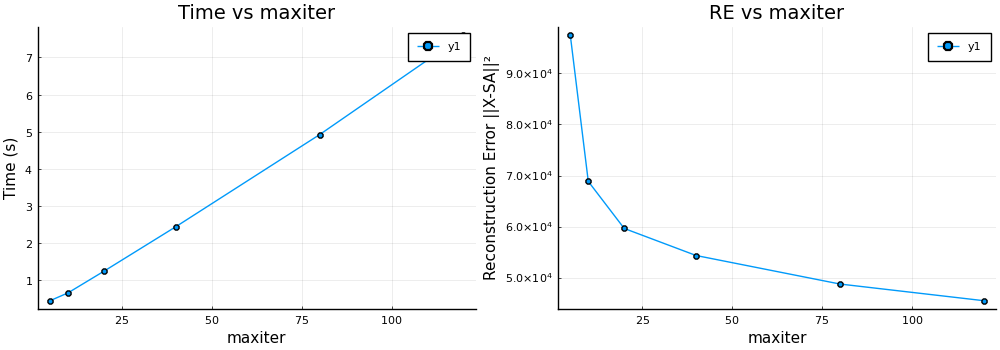

sys:1: UserWarning: No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored
sys:1: UserWarning: No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored
sys:1: UserWarning: No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored
sys:1: UserWarning: No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


In [19]:
using LinearAlgebra
using Base.Threads
using Plots
pyplot()

reconstruction_error(X, S, A) = norm(X - S*A)^2

maxiters = [5, 10, 20, 40, 80, 120]

results_time = Float64[]
results_RE   = Float64[]

println("Threads used : ", nthreads())

for maxiter in maxiters
    Atest = ones(size(A))   # même init pour comparer

    t0 = time()

    Threads.@threads for k in 1:(H*W)
        a = view(Atest, :, k)

        local_iteration = 0
        while norm(min.(a, StS*a - StX[:,k])) > epsilon && local_iteration < maxiter
            a .-= 2*stepsize * (StS*a - StX[:,k])
            proj_simplex(a)   # ANC + ASC
            local_iteration += 1
        end
    end

    t1 = time()
    push!(results_time, t1 - t0)

    RE = reconstruction_error(X, S, Atest)
    push!(results_RE, RE)
end

p_time = plot(maxiters, results_time, marker=:o, xlabel="maxiter", ylabel="Time (s)",
              title="Time vs maxiter")

p_re   = plot(maxiters, results_RE, marker=:o, xlabel="maxiter", ylabel="Reconstruction Error ||X-SA||²",
              title="RE vs maxiter")

#Plots

plot(p_time, p_re, layout=(1,2), size=(1000,350))


As shown in the figures, when using multi threading, the execution time increases approximately linearly with the maximum number of iterations. On the other hand, the reconstruction error decreases rapidly for small values of max_iter, and then progressively saturates, showing small improvements for larger values. With a fixed epsilon stopping criterion (used for kkt criterion), choosing max_iter between 25 and 50 provides a good trade-off between execution time and reconstruction accuracy.